In [ ]:
import matplotlib as mpl
print(mpl.colormaps())


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.linalg import expm
import seaborn as sns
import matplotlib.cm as cm
import matplotlib.ticker as ticker

# Use the Solarized Light style for improved aesthetics.
plt.style.use('Solarize_Light2')
# Optionally, comment out the Seaborn theme if desired:
# sns.set_theme(style="whitegrid", context="talk")

# ================================
# Define a 4x4 Hamiltonian \hat{H} (using a block structure)
# ================================
H = np.array([
    [0,    0,    0, 0],
    [0, -0.5,  0.5, 0],
    [0,  0.5, -0.5, 0],
    [0,    0,    0, 0]
], dtype=np.complex128)

# Optionally, compute the eigenvalues to analyze periodicity:
eigs = np.linalg.eigvals(H)
print("Eigenvalues of H:", eigs)
period = 4 * np.pi  # reference period (unused in this version)

# ================================
# Define the range for t with higher resolution
# ================================
num_points = 50000  # increased resolution for smooth curves
t_values = np.linspace(0, 12 * np.pi, num_points)

# Prepare lists to store determinant and trace results.
det_values = []
trace_values = []

# Compute e^(i \hat{H} t) for each t and extract determinant and trace.
for t in t_values:
    M = expm(1j * t * H)
    det_values.append(np.linalg.det(M))
    trace_values.append(np.trace(M))

det_values   = np.array(det_values)
trace_values = np.array(trace_values)

# Compute magnitudes and phases.
det_mag   = np.abs(det_values)
det_phase = np.angle(det_values)
trace_mag   = np.abs(trace_values)
trace_phase = np.angle(trace_values)

# ================================
# Create the high-resolution plot using Matplotlib's scatter for continuous colormapping.
# ================================
fig, ax = plt.subplots(figsize=(35, 10), dpi=400)

# Define common normalization and colormap for phase mapping.
norm = plt.Normalize(vmin=-np.pi, vmax=np.pi)
cmap = sns.color_palette("hsv", as_cmap=True)

# Scatter plot for determinant (circle markers).
sc_det = ax.scatter(t_values, det_mag, c=det_phase, cmap=cmap, norm=norm,
                    marker="o", s=20, alpha=0.8)

# Scatter plot for trace (square markers).
sc_trace = ax.scatter(t_values, trace_mag, c=trace_phase, cmap=cmap, norm=norm,
                      marker="s", s=20, alpha=0.8)

# Titles and labels.
ax.set_title(r"Trace and Determinant of $e^{i\hat{H}t}$ with Phase Color Mapping", fontsize=24)
ax.set_xlabel(r"$t$", fontsize=20)
ax.set_ylabel("Magnitude", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Create a colorbar to show phase information.
cbar = plt.colorbar(sc_det, ax=ax, orientation='vertical')
cbar.set_label("Phase (radians)", fontsize=20)
cbar.ax.tick_params(labelsize=16)

# Configure the colorbar ticks to display multiples of pi.
tick_locs = [-np.pi, -np.pi/2, 0, np.pi/2, np.pi]
tick_labels = [r'$-\pi$', r'$-\pi/2$', r'$0$', r'$\pi/2$', r'$\pi$']
cbar.set_ticks(tick_locs)
cbar.set_ticklabels(tick_labels)

plt.tight_layout()
plt.show()


Initializing 256-dim quantum system on mps...


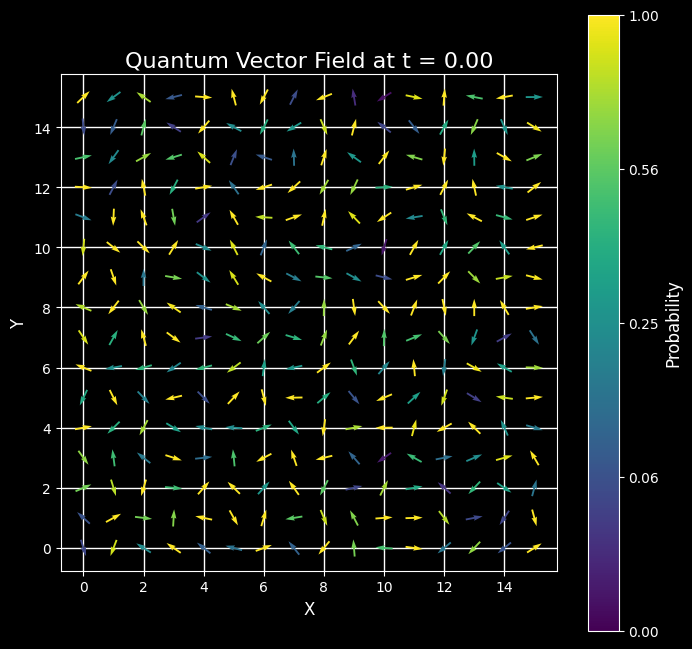

In [24]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 50e6  # Increase embed limit if needed

# Use a dark background style.
plt.style.use('dark_background')

import math
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# === Configuration ===
t_min, t_max = 0, 7
fps = 30              # frames per second for the animation
duration = 7          # total duration in seconds
num_frames = int(fps * duration)
n_qubits = 8         # For example, 6 qubits gives an 8x8 grid.
system_dim = 2 ** n_qubits  # Hilbert space dimension
s = int(np.sqrt(system_dim))  # Grid size (assumed square)

# Gamma for contrast enhancement (gamma < 1 boosts differences)
gamma = 0.5

# Set up device (using MPS if available, else CPU)
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# --- Quantum Gates Setup ---
I = torch.eye(2, dtype=torch.complex64, device=device)
X = torch.tensor([[0, 1], [1, 0]], dtype=torch.complex64, device=device)
Y = torch.tensor([[0, -1j], [1j, 0]], dtype=torch.complex64, device=device)
Z = torch.tensor([[1, 0], [0, -1]], dtype=torch.complex64, device=device)

def tensor_product(operators):
    result = operators[0]
    for op in operators[1:]:
        result = torch.kron(result, op)
    return result

# --- Hamiltonian Construction ---
def build_hamiltonian():
    pauli_gates = [I, X, Y, Z]
    num_terms = 10
    H = torch.zeros((system_dim, system_dim), dtype=torch.complex64, device=device)
    for _ in range(num_terms):
        gate_indices = torch.randint(0, 4, (n_qubits,))
        paulis = [pauli_gates[i] for i in gate_indices]
        H += torch.randn(1, device=device) * tensor_product(paulis)
    return (H + H.mH) / 2  # Ensure Hermiticity

print(f"Initializing {system_dim}-dim quantum system on {device}...")
H = build_hamiltonian()

# Prepare an initial random state (normalized)
V_rand = (torch.randn(system_dim, dtype=torch.complex64, device=device) +
          1j * torch.randn(system_dim, dtype=torch.complex64, device=device))
norm = torch.sqrt(torch.sum(torch.abs(V_rand) ** 2))  # manual norm for complex tensor
V_rand /= norm

# --- Compute Eigen Decomposition ---
H_cpu = H.cpu().to(torch.complex128)
eigvals, Q = torch.linalg.eigh(H_cpu)
eigvals = eigvals.to(device, dtype=torch.float32)
Q = Q.to(device, dtype=H.dtype)

# Precompute time values for the animation
t_values = np.linspace(t_min, t_max, num_frames)

# --- Set Up the Grid for the Vector Field ---
X_grid, Y_grid = np.meshgrid(np.arange(s), np.arange(s))
step = 1  # Show all grid points
X_plot = X_grid[::step, ::step]
Y_plot = Y_grid[::step, ::step]

def compute_state(t):
    """Compute the quantum state (reshaped as a grid) at time t."""
    phase_factors = torch.exp(-1j * eigvals * t)
    evolved = Q @ (phase_factors * (Q.mH @ V_rand))
    state = evolved.view(s, s)
    return state.cpu().numpy()

def get_vector_field(state):
    """
    Compute the arrow field for a given complex grid.
    - Arrow direction: phase (angle) of the complex number.
    - Arrow color: determined by the probability (squared magnitude), scaled and gamma corrected.
    """
    phase = np.angle(state)
    probability = np.abs(state)**2
    # Scale so a uniform state gives value 1 everywhere.
    p_raw = probability * (s * s)
    p_gamma = np.power(p_raw, gamma)
    
    U = np.cos(phase)
    V = np.sin(phase)
    U_plot = U[::step, ::step]
    V_plot = V[::step, ::step]
    p_plot = p_gamma[::step, ::step]
    return U_plot, V_plot, p_plot

# Initial state and vector field.
initial_state = compute_state(t_values[0])
U_plot, V_plot, p_plot = get_vector_field(initial_state)

# Constant normalization for color mapping (gamma-corrected values) over [0, 1].
const_norm = colors.Normalize(vmin=0, vmax=1)

fig, ax = plt.subplots(figsize=(8, 8))
q = ax.quiver(X_plot, Y_plot, U_plot, V_plot, p_plot,
              cmap='viridis', norm=const_norm, pivot='mid')
q.set_clim(0, 1)  # Force constant color limits

ax.set_title(f"Quantum Vector Field at t = {t_values[0]:.2f}", color='w')
ax.set_xlabel("X", color='w')
ax.set_ylabel("Y", color='w')
ax.tick_params(axis='both', colors='w')
ax.set_aspect('equal')

# Create and adjust the colorbar to show the actual (raw) probability.
cbar = fig.colorbar(q, ax=ax)
cbar.set_label("Probability", color='w')
# Adjust colorbar tick labels: inverse transform from gamma-corrected to raw probability.
ticks = np.linspace(0, 1, 5)  # in gamma-corrected space
raw_ticks = ticks ** (1/gamma)
cbar.set_ticks(ticks)
cbar.set_ticklabels(["{:.2f}".format(rt) for rt in raw_ticks])
plt.setp(plt.getp(cbar.ax, 'yticklabels'), color='w')  # Set tick label color

def update(frame):
    t = t_values[frame]
    state = compute_state(t)
    U_new, V_new, p_new = get_vector_field(state)
    q.set_UVC(U_new, V_new, p_new)
    ax.set_title(f"Quantum Vector Field at t = {t:.2f}", color='w')
    return q,

anim = FuncAnimation(fig, update, frames=num_frames, interval=1000/fps, blit=False)

# Embed the animation as HTML.
#plt.close(fig)
HTML(anim.to_jshtml())



In [34]:
import numpy as np
import sympy as sp
from scipy.linalg import expm

# Create a 3x3 identity matrix (you can change the size if needed)
I = np.eye(4)

# Multiply the identity matrix by the imaginary unit i (in Python, 1j)
iI = 0.875j * I

# Compute the matrix exponential using numpy.linalg.matrix_exp (available in NumPy 1.17+)
exp_iI = expm(iI)

print("i * I:")
display(iI)
print("\nMatrix exponential of i * I:")
display(exp_iI)


i * I:


array([[0.+0.875j, 0.+0.j   , 0.+0.j   , 0.+0.j   ],
       [0.+0.j   , 0.+0.875j, 0.+0.j   , 0.+0.j   ],
       [0.+0.j   , 0.+0.j   , 0.+0.875j, 0.+0.j   ],
       [0.+0.j   , 0.+0.j   , 0.+0.j   , 0.+0.875j]])


Matrix exponential of i * I:


array([[0.64099686+0.7675435j, 0.        +0.j       ,
        0.        +0.j       , 0.        +0.j       ],
       [0.        +0.j       , 0.64099686+0.7675435j,
        0.        +0.j       , 0.        +0.j       ],
       [0.        +0.j       , 0.        +0.j       ,
        0.64099686+0.7675435j, 0.        +0.j       ],
       [0.        +0.j       , 0.        +0.j       ,
        0.        +0.j       , 0.64099686+0.7675435j]])

In [45]:
import sympy as sp

# Define a 3x3 identity matrix.
I = sp.eye(3)
t = 0
# Multiply by the imaginary unit i (Sympy uses sp.I for the imaginary unit)
iI = sp.I * I * t

# Compute the matrix exponential.
exp_iI = iI.exp().evalf(4)

# Pretty-print the result.
display(exp_iI)


Matrix([
[1.0,   0,   0],
[  0, 1.0,   0],
[  0,   0, 1.0]])